# WEEK1

EDA

**Load libraries**

In [ ]:
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import plotly as py
%matplotlib inline

**Load Data**

In [ ]:
df = pd.read_excel('/content/area-production.xlsx')
df.head()

,STCODE,STNAME,DIST,DISTNAME,YEAR,RICE_KA,RICE_KQ,RICE_RA,RICE_RQ,RICE_SA,...,Unnamed: 400,Unnamed: 401,Unnamed: 402,Unnamed: 403,Unnamed: 404,Unnamed: 405,Unnamed: 406,Unnamed: 407,Unnamed: 408,Unnamed: 409
0,1,Andhra Pradesh,44,Srikakulam,1997,185.7,278.5,0.6,2.1,.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,Andhra Pradesh,44,Srikakulam,1998,194.4,370.7,2,7.5,.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,Andhra Pradesh,44,Srikakulam,1999,189.03,323.53,1.7,5.87,.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,Andhra Pradesh,44,Srikakulam,2000,207.46,399.16,1.1,2.01,.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,Andhra Pradesh,44,Srikakulam,2001,178.77,393.65,1.58,3.59,.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.drop(df.columns[df.columns.str.contains('Unnamed',case=False)],axis=1,inplace=True)

In [ ]:
pd.options.display.min_rows = 115
df.isnull().sum().sort_values(ascending=False)

RICE_KA      15
RICE_KQ       9
STCODE        0
COTN_TA       0
 MEST_KA      0
JUTE_TY       0
JUTE_TQ       0
JUTE_TA       0
JUTE_KQ       0
JUTE_KA       0
COTN_TY       0
COTN_TQ       0
COTN_RA       0
COTN_RQ       0
 MEST_TA      0
COTN_KQ       0
COTN_KA       0
SCAN_TY       0
SGUR_TQ       0
SCAN_TA       0
SGUR_RQ       0
SCAN_RA       0
 MEST_KQ      0
 MEST_TQ      0
SCAN_KA       0
 MEST_TY      0
ONIO_SA       0
ONIO_RQ       0
ONIO_RA       0
ONIO_KQ       0
             ..
HORS_TQ       0
HORS_TA       0
HORS_RQ       0
HORS_RA       0
HORS_KQ       0
HORS_KA       0
BLCK_TY       0
BLCK_TQ       0
GREN_RA       0
GREN_RQ       0
GREN_SA       0
GREN_SQ       0
COWP_KY       0
COWP_KQ.3     0
COWP_KA.3     0
COWP_KQ.2     0
COWP_KA.2     0
COWP_KQ.1     0
COWP_KA.1     0
COWP_KQ       0
COWP_KA       0
MOTH_TY       0
MOTH_TQ       0
MOTH_TA       0
MOTH_KQ       0
MOTH_KA       0
GREN_TY       0
GREN_TQ       0
GREN_TA       0
GUAR_TY       0
Length: 345, dtype: int6

### Analysing 52 crops is going to be difficult and wont be able to get the accuracy as the null values are more.Removing Crop with least area of cultivation. We have used Visualization to identify least performing crops(Area wise in below section 


## Understanding the data

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9765 entries, 0 to 9764
Columns: 345 entries, STCODE to GUAR_TY
dtypes: int64(3), object(342)
memory usage: 25.7+ MB


In [ ]:
df.dtypes

STCODE       int64
STNAME      object
DIST         int64
DISTNAME    object
YEAR         int64
RICE_KA     object
RICE_KQ     object
RICE_RA     object
RICE_RQ     object
RICE_SA     object
RICE_SQ     object
RICE_TA     object
RICE_TQ     object
RICE_TY     object
WHT_RA      object
WHT_RQ      object
WHT_TA      object
WHT_TQ      object
WHT_TY      object
SORG_KA     object
SORG_KQ     object
SORG_RA     object
SORG_RQ     object
SORG_SA     object
SORG_SQ     object
SORG_TA     object
SORG_TQ     object
SORG_TY     object
PMLT_KA     object
PMLT_KQ     object
             ...  
DRYC_KA     object
DRYC_KQ     object
DRYC_RA     object
DRYC_RQ     object
DRYC_SA     object
DRYC_SQ     object
DRYC_TA     object
DRYC_TQ     object
DRYC_TY     object
GARL_RA     object
GARL_RQ     object
GARL_TA     object
GARL_TQ     object
GARL_TY     object
GING_KA     object
GING_KQ     object
GING_TA     object
GING_TQ     object
GING_TY     object
BLKP_TA     object
BLKP_TQ     object
BLKP_TY     

In [ ]:
x = df.select_dtypes(['object']).columns
colls = list(x)
print(colls)

['STNAME', 'DISTNAME', 'RICE_KA', 'RICE_KQ', 'RICE_RA', 'RICE_RQ', 'RICE_SA', 'RICE_SQ', 'RICE_TA', 'RICE_TQ', 'RICE_TY', 'WHT_RA', 'WHT_RQ', 'WHT_TA', 'WHT_TQ', 'WHT_TY', 'SORG_KA', 'SORG_KQ', 'SORG_RA', 'SORG_RQ', 'SORG_SA', 'SORG_SQ', 'SORG_TA', 'SORG_TQ', 'SORG_TY', 'PMLT_KA', 'PMLT_KQ', 'PMLT_RA', 'PMLT_RQ', 'PMLT_SA', 'PMLT_SQ', 'PMLT_TA', 'PMLT_TQ', 'PMLT_TY', 'MAIZ_KA', 'MAIZ_KQ', 'MAIZ_RA', 'MAIZ_RQ', 'MAIZ_SA', 'MAIZ_SQ', 'MAIZ_TA', 'MAIZ_TQ', 'MAIZ_TY', 'FMLT_KA', 'FMLT_KQ', 'FMLT_RA', 'FMLT_RQ', 'FMLT_SA', 'FMLT_SQ', 'FMLT_TA', 'FMLT_TQ', 'FMLT_TY', 'BRLY_TA', 'BRLY_TQ', 'BRLY_RA', 'BRLY_RQ', 'BRLY_TA.1', 'BRLY_TQ.1', 'BRLY_TY', 'SMLM_KA', 'SMLM_KQ', 'SMLM_RA', 'SMLM_RQ', 'SMLM_SA', 'SMLM_SQ', 'SMLM_TA', 'SMLM_TQ', 'SMLM_TY', 'CPEA_RA', 'CPEA_RQ', 'CPEA_TA', 'CPEA_TQ', 'CPEA_TY', 'PPEA_KA', 'PPEA_KQ', 'PPEA_RA', 'PPEA_RQ', 'PPEA_TA', 'PPEA_TQ', 'PPEA_TY', 'BLCK_KA', 'BLCK_KQ', 'BLCK_RA', 'BLCK_RQ', 'BLCK_SA', 'BLCK_SQ', 'BLCK_TA', 'BLCK_TQ', 'BLCK_TY', 'HORS_KA', 'HORS_KQ',

In [ ]:
colls.remove('DISTNAME')
colls.remove('STNAME')
for col in colls:    
    df[col] = pd.to_numeric(df[col], errors='coerce')
df.dtypes

STCODE        int64
STNAME       object
DIST          int64
DISTNAME     object
YEAR          int64
RICE_KA     float64
RICE_KQ     float64
RICE_RA     float64
RICE_RQ     float64
RICE_SA     float64
RICE_SQ     float64
RICE_TA     float64
RICE_TQ     float64
RICE_TY     float64
WHT_RA      float64
WHT_RQ      float64
WHT_TA      float64
WHT_TQ      float64
WHT_TY      float64
SORG_KA     float64
SORG_KQ     float64
SORG_RA     float64
SORG_RQ     float64
SORG_SA     float64
SORG_SQ     float64
SORG_TA     float64
SORG_TQ     float64
SORG_TY     float64
PMLT_KA     float64
PMLT_KQ     float64
             ...   
DRYC_KA     float64
DRYC_KQ     float64
DRYC_RA     float64
DRYC_RQ     float64
DRYC_SA     float64
DRYC_SQ     float64
DRYC_TA     float64
DRYC_TQ     float64
DRYC_TY     float64
GARL_RA     float64
GARL_RQ     float64
GARL_TA     float64
GARL_TQ     float64
GARL_TY     float64
GING_KA     float64
GING_KQ     float64
GING_TA     float64
GING_TQ     float64
GING_TY     float64


In [ ]:
df.describe()

,STCODE,DIST,YEAR,RICE_KA,RICE_KQ,RICE_RA,RICE_RQ,RICE_SA,RICE_SQ,RICE_TA,...,BLKP_TQ,BLKP_TY,CARD_TA,CARD_TQ,CARD_TY,GUAR_KA,GUAR_KQ,GUAR_TA,GUAR_TQ,GUAR_TY
count,9765.000000,9765.000000,9765.000000,8679.000000,8649.000000,3131.000000,3116.000000,3141.000000,3123.00000,9093.000000,...,717.000000,717.000000,333.000000,284.000000,284.000000,661.000000,661.000000,1647.000000,1609.000000,1609.000000
mean,9.100870,527.419150,2006.275986,56.210773,122.330658,78.123855,161.033293,17.476835,42.97594,87.086504,...,2.676527,1555.875615,2.941201,0.632324,97.256929,0.440651,0.356172,34.475592,15.717371,889.552602
std,4.923874,453.713091,5.451729,69.655954,178.779386,81.200450,214.010430,43.287795,98.20852,96.459881,...,9.208070,1771.755018,7.115233,2.159962,180.141712,1.933640,1.532352,108.497280,56.711747,1843.624821
min,1.000000,1.000000,1997.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,132.000000,2002.000000,5.955000,7.440000,19.535000,28.885000,0.300000,0.62000,14.940000,...,0.030000,229.508197,0.060000,0.010000,57.674993,0.010000,0.010000,0.030000,0.020000,500.000000
50%,9.000000,520.000000,2006.000000,27.000000,44.290000,58.990000,86.355000,2.600000,5.16000,62.800000,...,0.150000,1333.333333,0.320000,0.040000,76.876905,0.030000,0.020000,0.200000,0.110000,750.000000
75%,12.000000,916.000000,2011.000000,86.000000,175.260000,105.990000,190.000000,13.160000,27.72000,122.050000,...,0.630000,2000.000000,1.500000,0.160000,98.835853,0.060000,0.050000,9.510000,5.010000,1000.000000
max,20.000000,2060.000000,2015.000000,545.970000,1710.000000,661.950000,1417.170000,687.000000,882.29000,920.000000,...,83.830000,13337.735849,33.080000,16.510000,2800.000000,20.100000,15.630000,1133.400000,622.040000,40000.000000


In [ ]:
df.shape

(9765, 345)

In [ ]:
pd.options.display.min_rows = 115
df.isnull().sum().sort_values(ascending=False)

OOIL_SA      9760
AREC_KQ      9756
AREC_KA      9756
TAPI_KA      9745
TAPI_KQ      9745
SMLM_SQ      9741
SMLM_SA      9738
BANA_KA      9737
BANA_KQ      9737
CASH_KQ      9706
CASH_KA      9706
SWTP_RA      9684
SWTP_RQ      9684
NIGS_RQ      9681
NIGS_RA      9681
COWP_KQ.2    9678
COWP_KA.2    9675
POTA_SA      9668
POTA_SQ      9668
TOBA_KQ      9636
TOBA_KA      9633
LENT_KQ      9630
LENT_KA      9630
AREC_RA      9630
AREC_RQ      9630
BRLY_TA      9598
BRLY_TQ      9598
TURM_KQ      9589
TURM_KA      9589
OOIL_KQ      9588
             ... 
WHT_RA       1946
CPEA_TY      1909
CPEA_TQ      1909
RM_TA        1876
PPEA_TA      1874
SCAN_TY      1871
SGUR_TQ      1871
SCAN_TA      1775
CPEA_TA      1770
SESA_TQ      1695
SESA_TY      1695
WHT_TY       1611
WHT_TQ       1611
MAIZ_KQ      1599
WHT_TA       1590
SESA_TA      1485
MAIZ_KA      1448
MAIZ_TY      1192
MAIZ_TQ      1192
RICE_KQ      1116
RICE_KA      1086
MAIZ_TA      1040
RICE_TQ       686
RICE_TY       686
RICE_TA   

## Transposing the Data , Convert Columns to Row data

We have around 345 columns with which identifying a target value is difficult. Hence the data is formatted to add new Columns Area,Production and Crop, and filling in the transposed data

In [ ]:

listArea=[c for c in df if (c.endswith('A') and not (c.endswith('TA')))] #and reference the list in the melt function
listArea
listProduction=[c for c in df if (c.endswith('Q') and not (c.endswith('TQ')))] #and reference the list in the melt function
listProduction

cols = listArea + listProduction

staticcolumns = ["STCODE","STNAME","DIST","DISTNAME","YEAR"] 
df1 = df.melt(id_vars=staticcolumns ,value_vars=listArea,var_name='Crop',value_name='Area')
df2 = df.melt(id_vars=staticcolumns ,value_vars=listProduction,var_name='Season',value_name='Production')

df1 = df1.set_index(["STCODE","STNAME","DIST","DISTNAME","YEAR", df1.groupby(["STCODE","STNAME","DIST","DISTNAME","YEAR"]).cumcount()])
df2 = df2.set_index(["STCODE","STNAME","DIST","DISTNAME","YEAR", df2.groupby(["STCODE","STNAME","DIST","DISTNAME","YEAR"]).cumcount()])


df3 = (pd.concat([df1, df2],axis=1)
         .sort_index(level=5)
         .reset_index(level=5, drop=True)
         .reset_index())
df3

#In this dataset Crop And Season shows Label actually implies the crop name we could label it meaningfully Hence the header is given as Crop and Season

,STCODE,STNAME,DIST,DISTNAME,YEAR,Crop,Area,Season,Production
0,1,Andhra Pradesh,44,Srikakulam,1997,RICE_KA,185.70,RICE_KQ,278.50
1,1,Andhra Pradesh,44,Srikakulam,1998,RICE_KA,194.40,RICE_KQ,370.70
2,1,Andhra Pradesh,44,Srikakulam,1999,RICE_KA,189.03,RICE_KQ,323.53
3,1,Andhra Pradesh,44,Srikakulam,2000,RICE_KA,207.46,RICE_KQ,399.16
4,1,Andhra Pradesh,44,Srikakulam,2001,RICE_KA,178.77,RICE_KQ,393.65
5,1,Andhra Pradesh,44,Srikakulam,2002,RICE_KA,153.15,RICE_KQ,267.55
6,1,Andhra Pradesh,44,Srikakulam,2003,RICE_KA,188.22,RICE_KQ,421.80
7,1,Andhra Pradesh,44,Srikakulam,2004,RICE_KA,190.80,RICE_KQ,448.56
8,1,Andhra Pradesh,44,Srikakulam,2005,RICE_KA,153.52,RICE_KQ,271.43
9,1,Andhra Pradesh,44,Srikakulam,2006,RICE_KA,193.99,RICE_KQ,491.78


In [ ]:
data= df3.join(df3['Crop'].str.split('_', 1, expand=True).rename(columns={0:'Crops', 1:'Seasons'}))

In [ ]:
data = data.drop(['Crop','Season'], axis = 1)

In [ ]:
data['Seasons'] = data['Seasons'].map({'KA':'Kharif', 'RA':'Rabi','SA':'Summer'}).fillna(data['Seasons'])
data['Seasons'].unique()

array(['Kharif', 'Rabi', 'Summer'], dtype=object)

In [ ]:
data.head()

,STCODE,STNAME,DIST,DISTNAME,YEAR,Area,Production,Crops,Seasons
0,1,Andhra Pradesh,44,Srikakulam,1997,185.70,278.50,RICE,Kharif
1,1,Andhra Pradesh,44,Srikakulam,1998,194.40,370.70,RICE,Kharif
2,1,Andhra Pradesh,44,Srikakulam,1999,189.03,323.53,RICE,Kharif
3,1,Andhra Pradesh,44,Srikakulam,2000,207.46,399.16,RICE,Kharif
4,1,Andhra Pradesh,44,Srikakulam,2001,178.77,393.65,RICE,Kharif


In [ ]:
pd.options.display.min_rows = 115
data.isnull().sum().sort_values(ascending=False)

Production    688411
Area          685564
STCODE             0
STNAME             0
DIST               0
DISTNAME           0
YEAR               0
Crops              0
Seasons            0
dtype: int64

In [ ]:
features_with_na=[features for features in data.columns if data[features].isnull().sum()>1]

for feature in features_with_na:
    print(feature,np.round(data[feature].isnull().mean(),2),'%missing values')

Area 0.78 %missing values
Production 0.78 %missing values


In [ ]:
grouped = data.groupby('Crops')['Area'].sum().sort_values(ascending=True).reset_index()
grouped

,Crops,Area
0,TAPI,41.52
1,SANH,83.72
2,BANA,108.35
3,CORI,161.18
4,SWTP,221.45
5,TURM,235.25
6,GUAR,291.27
7,AREC,341.90
8,GING,343.90
9,GARL,368.83


In [ ]:
listcrops = grouped.tail(10)["Crops"].tolist()
listcrops

['RM', 'GNUT', 'MAIZ', 'CPEA', 'SOYA', 'SORG', 'PMLT', 'COTN', 'WHT', 'RICE']

In [ ]:

data1 =  data[data.Crops.isin(listcrops)]
data1

,STCODE,STNAME,DIST,DISTNAME,YEAR,Area,Production,Crops,Seasons
0,1,Andhra Pradesh,44,Srikakulam,1997,185.70,278.50,RICE,Kharif
1,1,Andhra Pradesh,44,Srikakulam,1998,194.40,370.70,RICE,Kharif
2,1,Andhra Pradesh,44,Srikakulam,1999,189.03,323.53,RICE,Kharif
3,1,Andhra Pradesh,44,Srikakulam,2000,207.46,399.16,RICE,Kharif
4,1,Andhra Pradesh,44,Srikakulam,2001,178.77,393.65,RICE,Kharif
5,1,Andhra Pradesh,44,Srikakulam,2002,153.15,267.55,RICE,Kharif
6,1,Andhra Pradesh,44,Srikakulam,2003,188.22,421.80,RICE,Kharif
7,1,Andhra Pradesh,44,Srikakulam,2004,190.80,448.56,RICE,Kharif
8,1,Andhra Pradesh,44,Srikakulam,2005,153.52,271.43,RICE,Kharif
9,1,Andhra Pradesh,44,Srikakulam,2006,193.99,491.78,RICE,Kharif


In [ ]:
data1.Crops.unique()

array(['RICE', 'WHT', 'SORG', 'PMLT', 'MAIZ', 'CPEA', 'GNUT', 'RM',
       'SOYA', 'COTN'], dtype=object)

In [ ]:
features_with_na=[features for features in data1.columns if data1[features].isnull().sum()>1]

for feature in features_with_na:
    print(feature,np.round(data1[feature].isnull().mean(),2),'%missing values')

Area 0.6 %missing values
Production 0.62 %missing values


In [ ]:
pd.options.display.min_rows = 115
data1.isnull().sum().sort_values(ascending=False)

Production    126185
Area          122604
STCODE             0
STNAME             0
DIST               0
DISTNAME           0
YEAR               0
Crops              0
Seasons            0
dtype: int64

In [ ]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 205065 entries, 0 to 615194
Data columns (total 9 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   STCODE      205065 non-null  int64  
 1   STNAME      205065 non-null  object 
 2   DIST        205065 non-null  int64  
 3   DISTNAME    205065 non-null  object 
 4   YEAR        205065 non-null  int64  
 5   Area        82461 non-null   float64
 6   Production  78880 non-null   float64
 7   Crops       205065 non-null  object 
 8   Seasons     205065 non-null  object 
dtypes: float64(2), int64(3), object(4)
memory usage: 15.6+ MB


## Checking for Correlation between variables

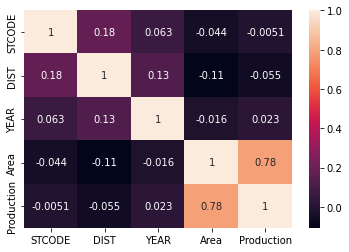

In [ ]:
plt.tick_params(labelsize=10)
sns.heatmap(data.corr(),annot=True);


There is no variable showing high correlation with any other variable in the dataset

## Univariate Analysis

There are 20 unique state names

In [ ]:
data.STNAME.unique()
data.STNAME.nunique()

20

In [ ]:
data.STNAME.value_counts()

Uttar Pradesh       125010
Madhya Pradesh       84780
Bihar                69210
Maharashtra          56070
Rajasthan            55620
Odisha               51300
Tamil Nadu           50670
Karnataka            47700
Assam                43290
Gujarat              41490
Andhra Pradesh       36360
Punjab               32580
Haryana              32310
West Bengal          30960
Chhattisgarh         28980
Jharkhand            28800
Kerala               23940
Himachal Pradesh     19440
Uttarakhand          18720
Telangana             1620
Name: STNAME, dtype: int64

This dataset encodes agriculture data for 20 Indian States

df.STNAME.value_counts() helps to see the quantum of levels present. As seen below,we have more data from top agriculture rich states like Uttar Pradesh,Madhya Pradesh,Bihar than other states.

## District Variable

In [ ]:
data.DISTNAME.unique()

array(['Srikakulam', 'Visakhapatanam', 'East Godavari', 'West Godavari',
       'Krishna', 'Guntur', 'Spsr Nellore', 'Kurnool', 'Anantapur',
       'Kadapa', 'Chittoor', 'Hyderabad', 'Nizamabad', 'Medak',
       'Mahbubnagar', 'Nalgonda', 'Warangal', 'Khammam', 'Karimnagar',
       'Adilabad', 'Vizianagaram', 'Prakasam', 'Rangareddy',
       'Muzaffarpur', 'Darbhanga', 'Saharsa', 'Purnia', 'Saran', 'Patna',
       'Munger', 'Bhagalpur', 'Dumka', 'Gaya', 'Hazaribagh', 'Dhanbad',
       'Palamu', 'Ranchi', 'Nalanda', 'Nawada', 'Aurangabad', 'Bhojpur',
       'Rohtas', 'Siwan', 'Gopalganj', 'Purbi Champaran',
       'Pashchim Champaran', 'Vaishali', 'Sitamarhi', 'Madhubani',
       'Samastipur', 'Begusarai', 'Katihar', 'Giridih', 'Jehanabad',
       'Madhepura', 'Khagaria', 'Godda', 'Sahebganj', 'Deoghar',
       'Lohardaga', 'Gumla', 'East Singhbum', 'West Singhbhum', 'Araria',
       'Kishanganj', 'Buxar', 'Kaimur (Bhabua)', 'Banka', 'Jamui',
       'Supaul', 'Chatra', 'Bokaro', 'Garhwa

In [ ]:
data.DISTNAME.nunique()

551

In [ ]:
data.DISTNAME.value_counts()

Aurangabad         3420
Hamirpur           3330
Bilaspur           3330
Pratapgarh         2610
Bijapur            2610
Balrampur          2160
Udaipur            1710
Vellore            1710
Cuddalore          1710
Kanchipuram        1710
Karauli            1710
Hanumangarh        1710
Rajsamand          1710
Dausa              1710
Baran              1710
Dholpur            1710
Srikakulam         1710
Coimbatore         1710
Tonk               1710
Sirohi             1710
Sikar              1710
Sawai Madhopur     1710
Pali               1710
Nagaur             1710
Kota               1710
Jodhpur            1710
Jhunjhunu          1710
Jhalawar           1710
Jalore             1710
Jaisalmer          1710
                   ... 
Tiruppur            720
Khunti              720
Palwal              630
Kasganj             630
Yadgir              540
Amethi              540
Pathankot           450
Sukma               450
Mungeli             450
Kondagaon           450
Gariyaband      


On District front, we have have more data coming from Aurangabad,Hamirpur,Bilaspur,Bijapur from Bihar, Uttar Pradesh,Chhattisgarh states.

## Year Variable

In [ ]:
print(data.YEAR.nunique())

19


In [ ]:
print(data.YEAR.min())

1997


In [ ]:
print(data.YEAR.max())

2015


In [ ]:
print(data.YEAR.value_counts())

2014    50040
2013    49230
2012    49140
2011    48960
2015    48150
2010    47880
2009    47700
2008    47610
2007    46800
2006    46440
2005    46350
2004    45720
2003    45720
2002    44550
1999    44460
1998    44010
2001    42750
2000    42750
1997    40590
Name: YEAR, dtype: int64


Our Dataset has data for 19 years from 1997 to 2015. Top years are 2013, 2011, 2014 and 2015.

## Area Variable

In [ ]:
print(data.Area.nunique())
print(data.Area.max())
print(data.Area.value_counts().head(10))
print(data.Area.value_counts().tail(10))

14098
1020.18
0.01    10021
0.00     8827
0.02     6003
0.03     4377
0.10     4075
0.04     3404
0.05     3077
0.06     2637
0.20     2328
0.07     2209
Name: Area, dtype: int64
242.86    1
172.74    1
179.93    1
206.57    1
214.48    1
211.60    1
201.83    1
208.43    1
229.60    1
41.14     1
Name: Area, dtype: int64


We have proportion of area under cultivation for different states and districts. Production depends on the proportion of area allocated for cultivation.

## Production Variable

In [ ]:
data.Production.describe()

count    190439.000000
mean         26.997462
std         100.473152
min           0.000000
25%           0.100000
50%           0.780000
75%           7.000000
max        3530.570000
Name: Production, dtype: float64

Production values range from 0 to 1.597800e+06

In [ ]:
print(data.Crops.nunique())
print(data.Crops.unique())
print(data.Crops.max())
print(data.Crops.value_counts().head(20))

49
['RICE' 'WHT' 'SORG' 'PMLT' 'MAIZ' 'FMLT' 'BRLY' 'SMLM' 'CPEA' 'PPEA'
 'BLCK' 'HORS' 'LENT' 'GREN' 'MOTH' 'COWP' 'PEBE' 'KHES' 'OKFP' 'ORBP'
 'GNUT' 'SESA' 'RM' 'SAFF' 'CAST' 'LINS' 'SUNF' 'SOYA' 'NIGS' 'OOIL'
 'SCAN' 'COTN' 'JUTE' ' MEST' 'SANH' 'TOBA' 'ONIO' 'POTA' 'SWTP' 'TURM'
 'CORI' 'TAPI' 'AREC' 'CASH' 'BANA' 'DRYC' 'GARL' 'GING' 'GUAR']
WHT
RICE    29295
BLCK    29295
GNUT    29295
OOIL    29295
ONIO    29295
GREN    29295
POTA    29295
SUNF    29295
SESA    29295
SMLM    29295
DRYC    29295
FMLT    29295
MAIZ    29295
PMLT    29295
SORG    29295
AREC    19530
BANA    19530
TOBA    19530
COTN    19530
SCAN    19530
Name: Crops, dtype: int64


Dataset shows data for 49 different crop varieties. On doing data.value_counts(), we can show top crops are Rice,Maize.

## Season Variable

In [ ]:
print(data.Seasons.nunique())
print(data.Seasons.unique())
print(data.Seasons.max())
print(data.Seasons.value_counts())

3
['Kharif' 'Rabi' 'Summer']
Summer
Kharif    380835
Rabi      341775
Summer    156240
Name: Seasons, dtype: int64


Dataset talks of 3 different seasons i.e. Kharif, Rabi,And Summer

{'boxes': [<matplotlib.lines.Line2D at 0x7fb57c4b1ad0>],
 'caps': [<matplotlib.lines.Line2D at 0x7fb57c264e10>,
 'fliers': [<matplotlib.lines.Line2D at 0x7fb57c166d50>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x7fb57c166810>],
 'whiskers': [<matplotlib.lines.Line2D at 0x7fb57c264550>,
  <matplotlib.lines.Line2D at 0x7fb57c2648d0>]}

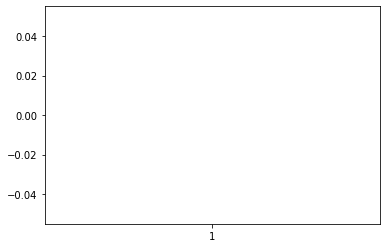

In [ ]:
plt.boxplot(data.Area);

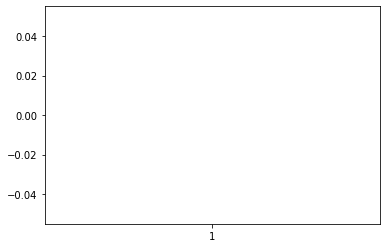

In [ ]:

plt.boxplot(data.Production);


Looking at distribution of Area and Production variables. These two variables are highly skewed with lot of outliers.

## BiVarate Analysis

In [ ]:
Prod = data.groupby(by = df.STNAME)['Production','STNAME'].sum().reset_index().sort_values(by = 'Production', ascending = True).tail(10)
Prod

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,STNAME,Production
12,Odisha,27525.64
10,Madhya Pradesh,40118.18
11,Maharashtra,47471.94
8,Karnataka,51398.68
5,Haryana,57348.30
3,Chhattisgarh,86653.04
15,Tamil Nadu,108553.33
0,Andhra Pradesh,127734.32
13,Punjab,191525.00
17,Uttar Pradesh,232399.45


Utter pradesh is top state when we look at the quantum of Production for last 19.years.

## Exploratory Analysis and Visualization

Dataset has been preprocessed for next step that’s Exploring all the variables and their levels(for categorical variables) for extracting important insights which defines the Indian cultivation and how its progressing in future.

In [ ]:
data.describe()

,STCODE,DIST,YEAR,Area,Production
count,878850.000000,878850.000000,878850.000000,193286.000000,190439.000000
mean,9.100870,527.419150,2006.275986,15.089661,26.997462
std,4.923625,453.690117,5.451453,43.463458,100.473152
min,1.000000,1.000000,1997.000000,0.000000,0.000000
25%,5.000000,132.000000,2002.000000,0.100000,0.100000
50%,9.000000,520.000000,2006.000000,0.930000,0.780000
75%,12.000000,916.000000,2011.000000,6.970000,7.000000
max,20.000000,2060.000000,2015.000000,1020.180000,3530.570000


(array([1.7669e+05, 8.6030e+03, 3.6750e+03, 2.1670e+03, 9.8900e+02,
        4.9800e+02, 2.5100e+02, 1.3800e+02, 1.1900e+02, 5.4000e+01,
        3.4000e+01, 9.0000e+00, 1.4000e+01, 1.6000e+01, 8.0000e+00,
        5.0000e+00, 3.0000e+00, 5.0000e+00, 6.0000e+00, 2.0000e+00]),
 array([   0.   ,   51.009,  102.018,  153.027,  204.036,  255.045,
         306.054,  357.063,  408.072,  459.081,  510.09 ,  561.099,
         612.108,  663.117,  714.126,  765.135,  816.144,  867.153,
         918.162,  969.171, 1020.18 ]),
 <a list of 20 Patch objects>)

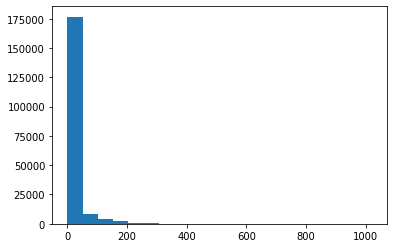

In [ ]:
plt.hist(data.Area, bins = 20)

(array([177266.,   5937.,   2882.,   1658.,    943.,    507.,    314.,
           257.,    220.]),
 array([  0, 100, 200, 300, 400, 500, 600, 700, 800, 900]),
 <a list of 9 Patch objects>)

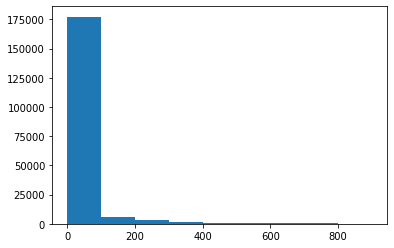

In [ ]:
plt.hist(data.Production, bins =[0,100,200,300,400,500,600,700,800,900])

## New Variables

Looking at the seven variables, we could extract more information if new variable could be created using present variables.

A possibility is: Different zones (Union Terr, South Zone, NE Zone, East Zone, North Zone, Central Zone and West Zone).

In [ ]:
#Zone-Wise Production - 1997-2015
north_india = ['Punjab', 'Himachal Pradesh', 'Haryana','Rajasthan']
east_india = ['Bihar', 'Odisha', 'Jharkhand', 'West Bengal']
south_india = ['Andhra Pradesh', 'Karnataka', 'Kerala' ,'Tamil Nadu', 'Telangana']
west_india = ['Gujarat', 'Goa','Maharashtra']
central_india = ['Madhya Pradesh', 'Chhattisgarh','Uttar Pradesh','Uttarakhand']
north_east_india = ['Assam', 'Sikkim', 'Nagaland', 'Meghalaya', 'Manipur', 'Mizoram', 'Tripura', 'Arunachal Pradesh']
ut_india = ['Andaman and Nicobar Islands', 'Dadra and Nagar Haveli', 'Puducherry','Chandigarh','Daman and Diu','Delhi','Jammu and Kashmir','ladakh','Lakshadweep','Puducherry']

In [ ]:
def get_zonal_names(row):
    if row['STNAME'].strip() in north_india:
        val = 'North Zone'
    elif row['STNAME'].strip()  in south_india:
        val = 'South Zone'
    elif row['STNAME'].strip()  in east_india:
        val = 'East Zone'
    elif row['STNAME'].strip()  in west_india:
        val = 'West Zone'
    elif row['STNAME'].strip()  in central_india:
        val = 'Central Zone'
    elif row['STNAME'].strip()  in north_east_india:
        val = 'NE Zone'
    elif row['STNAME'].strip()  in ut_india:
        val = 'Union Terr'
    else:
        val = 'No Value'
    return val

data['Zones'] = data.apply(get_zonal_names, axis=1)
data['Zones'].unique()

array(['South Zone', 'East Zone', 'West Zone', 'North Zone',
       'Central Zone', 'NE Zone'], dtype=object)

In [ ]:
data.Zones.value_counts()

Central Zone    257490
East Zone       180270
South Zone      160290
North Zone      139950
West Zone        97560
NE Zone          43290
Name: Zones, dtype: int64

Using Zonal information, we can decipher the top zones are Cental India,and East India

## Visualization on Important variables:

## 1.Overall Crop Production By state

In [ ]:
temp = data.groupby(by='STNAME')['Production'].sum().reset_index().sort_values(by='Production')
px.bar(temp, 'STNAME', 'Production',title='Overall Crop Production By state')

Uttar pradesh is the highest crops producing state overall. Top 3 crop producing states are from north India,east India, which put together leave no space to compare rest states

## 2.Productivity of different states

In [ ]:
temp = data.groupby('STNAME')['Area', 'Production'].sum().reset_index()
temp['Production_Per_Unit_Area'] = temp['Production']/temp['Area']
temp = temp.sort_values(by='Production_Per_Unit_Area')
px.bar(temp, 'STNAME', 'Production_Per_Unit_Area', color='Production_Per_Unit_Area',title='Productivity of different states' )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.



Punjab is the most productive state when we compare in terms of production by area.

## 3.Overall production through years

In [ ]:
temp = data.groupby(by='YEAR')['Production'].sum().reset_index()
px.line(temp, 'YEAR', 'Production',title='Overall production through years')

## 4.Average Crop Area through years

In [ ]:
temp = data.groupby(by='YEAR')['Area'].mean().reset_index()
px.scatter(temp, 'YEAR', 'Area', color='Area', size='Area',title='Average Crop Area through years')

Average Crop Area has decresed over the years. We had the lowest Average Crop area in 2015 and highest in 1997.

## 5.Most and Least crop producing districts

In [ ]:
import plotly.graph_objects as go
fig = py.subplots.make_subplots(rows=1,cols=2,
                    subplot_titles=('Highest crop producing districts', 'Least overall crop producing districts'))

temp = data.groupby(by='DISTNAME')['Production'].sum().reset_index().sort_values(by='Production')
temp1 = temp.tail(8)
trace1 = go.Bar(x= temp1['DISTNAME'], y=temp1['Production'])

temp1=temp.head(8)
trace2 = go.Bar(x= temp1['DISTNAME'], y=temp1['Production'])

fig.append_trace(trace1,1,1)
fig.append_trace(trace2,1,2)
fig.show()
del temp,temp1

Higest crop producing dustrict are in punjab.

## 6.Most produced crops

In [ ]:
temp = data.groupby(by='Crops')['Production'].sum().reset_index().sort_values(by='Production')
px.bar(temp.tail(10), 'Crops', 'Production',title='Most produced crops')

Rice and Wheat are the most produced crop

# Least Cultivated Crops

In [ ]:
temp = data.groupby(by='Crops')['Area'].sum().reset_index().sort_values(by='Area')
px.bar(temp.head(10), 'Crops', 'Area',title='Less cultivated crop')

# New Section

#Most cultivated Crops

In [ ]:
temp = data.groupby(by='Crops')['Area'].sum().reset_index().sort_values(by='Area')
px.bar(temp.tail(10), 'Crops', 'Area',title='Most cultivated crops')

## Season with more production

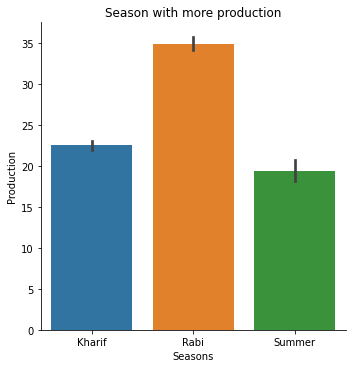

In [ ]:
sns.catplot(x='Seasons',y='Production',kind='bar',data=data).set(title='Season with more production')

Rabi Season has more production , and Summer has least

In [ ]:
fig= px.area(data, x = 'YEAR', y ='Production', color = 'Crops',title='Year wise crop production')
fig.show() 

In [ ]:
px.area(data,x='Crops',y='Area',title='Area vs Crops')

# WEEK 2
Data preprocessing

## DATA PREPROCESSING

## **1.Handling missing values in the dataset**

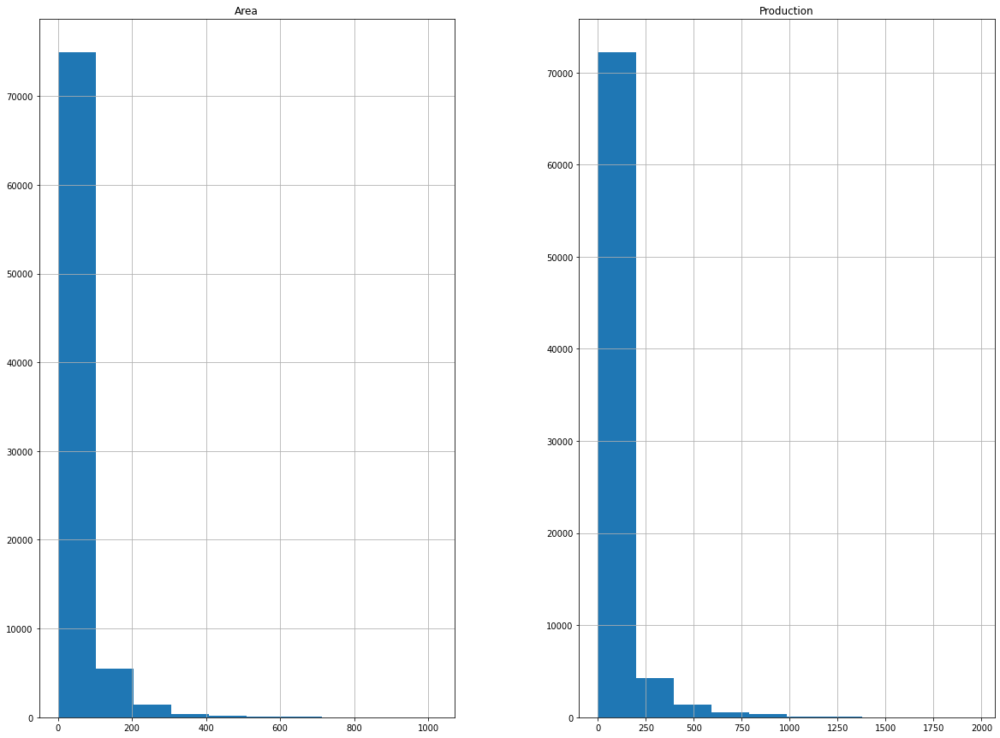

In [ ]:
fregraph = data1.select_dtypes(include=['float'])
fregraph.hist(figsize=(20,15))
plt.show()

In [ ]:
data1.columns

Index(['STCODE', 'STNAME', 'DIST', 'DISTNAME', 'YEAR', 'Area', 'Production',
       'Crops', 'Seasons'],
      dtype='object')

In [ ]:
data1.isnull().sum()

STCODE             0
STNAME             0
DIST               0
DISTNAME           0
YEAR               0
Area          122604
Production    126185
Crops              0
Seasons            0
dtype: int64

There are 126185 null values in production and 122604 null values in area.

In [ ]:
g=data1.groupby('Crops')

groupByNull = -g.count().sub(g.size(),0)

sorted = groupByNull.sort_values(by=['Area'], ascending=False)
newdf = sorted.drop(sorted[sorted.Area > 14500].index)
newdf


,STCODE,STNAME,DIST,DISTNAME,YEAR,Area,Production,Seasons
Crops,,,,,,,,
RICE,0,0,0,0,0,14344,14407,0
SOYA,0,0,0,0,0,6627,6658,0
RM,0,0,0,0,0,2108,2175,0
CPEA,0,0,0,0,0,1975,2109,0
WHT,0,0,0,0,0,1946,1962,0


In [ ]:
listOfCropsToInclude =['RM','CPEA', 'SOYA','WHT', 'RICE']
data1 =  data1[data1.Crops.isin(listOfCropsToInclude)]
data1

,STCODE,STNAME,DIST,DISTNAME,YEAR,Area,Production,Crops,Seasons
0,1,Andhra Pradesh,44,Srikakulam,1997,185.70,278.50,RICE,Kharif
1,1,Andhra Pradesh,44,Srikakulam,1998,194.40,370.70,RICE,Kharif
2,1,Andhra Pradesh,44,Srikakulam,1999,189.03,323.53,RICE,Kharif
3,1,Andhra Pradesh,44,Srikakulam,2000,207.46,399.16,RICE,Kharif
4,1,Andhra Pradesh,44,Srikakulam,2001,178.77,393.65,RICE,Kharif
5,1,Andhra Pradesh,44,Srikakulam,2002,153.15,267.55,RICE,Kharif
6,1,Andhra Pradesh,44,Srikakulam,2003,188.22,421.80,RICE,Kharif
7,1,Andhra Pradesh,44,Srikakulam,2004,190.80,448.56,RICE,Kharif
8,1,Andhra Pradesh,44,Srikakulam,2005,153.52,271.43,RICE,Kharif
9,1,Andhra Pradesh,44,Srikakulam,2006,193.99,491.78,RICE,Kharif


In [ ]:
data1['Area'] = data1['Area'].fillna(data1.groupby('Crops')['Area'].transform('median'))
data1['Production'] = data1['Production'].fillna(data1.groupby('Crops')['Production'].transform('median'))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
data1.isnull().sum()

STCODE        0
STNAME        0
DIST          0
DISTNAME      0
YEAR          0
Area          0
Production    0
Crops         0
Seasons       0
dtype: int64

In [ ]:
data1.shape

(68355, 9)

Now there is no null values in the dataset.

## **2.Outlier Detection and Handling**

(array([1, 2, 3, 4, 5]), <a list of 5 Text major ticklabel objects>)

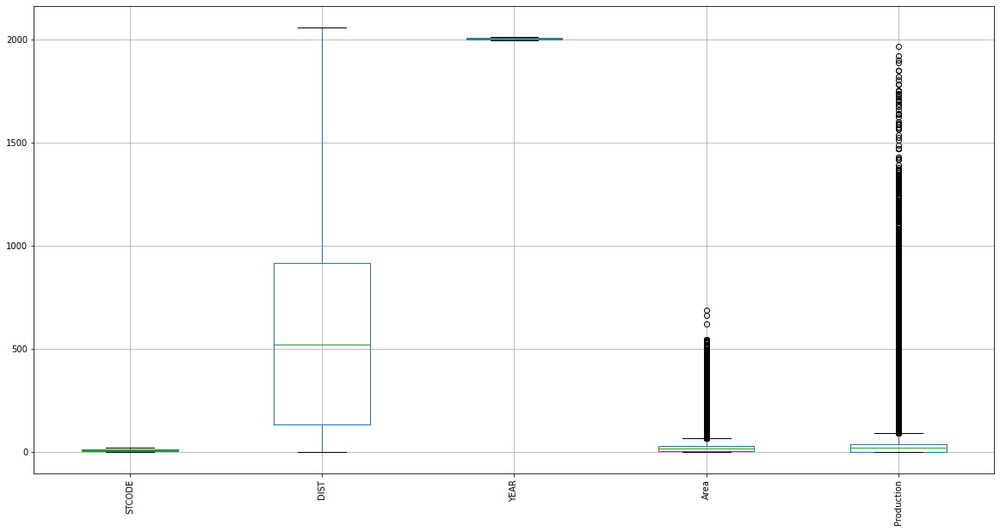

In [ ]:
#plotting boxplot
plt.figure(figsize=(20, 10))
data1.boxplot()
plt.xticks(rotation=90)

In [ ]:
data.dtypes

STCODE          int64
STNAME         object
DIST            int64
DISTNAME       object
YEAR            int64
Area          float64
Production    float64
Crops          object
Seasons        object
dtype: object

In [ ]:
#finding the 25 th percentile and 75 th percentile
Q1=data1.quantile(0.25)
Q3=data1.quantile(0.75)

#Inter Quantile Range
IQR=Q3-Q1

#Finding lower and upper bounds for all values.All values outside these bounds are outliers
lower_limit=Q1-1.5*IQR
upper_limit=Q3+1.5*IQR

#finding the sum of the outliers in each column of int and float types.
((data1.select_dtypes(include=['float64','int64'])<lower_limit) | (data1.select_dtypes(include=['float64','int64'])>upper_limit)).sum()

STCODE            0
DIST              0
YEAR              0
Area           9277
Production    10389
dtype: int64

**Case1:Area**

Text(0.5, 1.0, 'Box plot of Area')

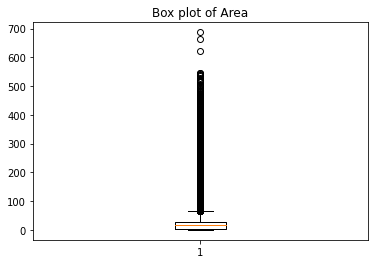

In [ ]:
#checking the outlier in Area
plt.boxplot(data1['Area'])
plt.title('Box plot of Area')

In [ ]:
Q1 = np.percentile(data1['Area'],25,interpolation='midpoint')
Q2 = np.percentile(data1['Area'],50,interpolation='midpoint')
Q3 = np.percentile(data1['Area'],75,interpolation='midpoint')
print('Q1-',Q1)
print('Q2-',Q2)
print('Q3-',Q3)
#find the interquartile range IQR
IQR = Q3 - Q1
print('IQR-',IQR)
low_limit = Q1 - 1.5 * IQR
upper_limit = Q3 + 1.5 * IQR
print('low_limit-',low_limit)
print('upper_limit-',upper_limit)

Q1- 1.98
Q2- 16.8
Q3- 27.84
IQR- 25.86
low_limit- -36.81
upper_limit- 66.63


In [ ]:
#Removing outlier using the loop
out=[]
for x in data['Area']:
    if((x>upper_limit)or(x<low_limit)):
        out.append(x)

In [ ]:
out

[185.7,
 194.4,
 189.03,
 207.46,
 178.77,
 153.15,
 188.22,
 190.8,
 153.52,
 193.99,
 201.0,
 203.17,
 177.06,
 205.85,
 208.24,
 206.0,
 199.72,
 205.49,
 204.0,
 95.6,
 114.9,
 103.37,
 115.24,
 86.58,
 84.68,
 95.19,
 84.81,
 93.13,
 96.0,
 99.38,
 110.29,
 109.51,
 99.0,
 98.64,
 98.19,
 103.09,
 214.1,
 256.3,
 244.66,
 253.97,
 220.81,
 194.81,
 234.67,
 224.52,
 217.41,
 227.93,
 242.0,
 240.23,
 202.15,
 237.64,
 197.45,
 232.0,
 235.16,
 226.07,
 227.84,
 247.2,
 262.0,
 267.08,
 272.9,
 222.72,
 214.55,
 232.24,
 244.24,
 253.52,
 245.24,
 254.0,
 255.44,
 212.89,
 256.15,
 240.27,
 243.0,
 240.4,
 231.48,
 229.2,
 257.9,
 280.8,
 278.42,
 281.34,
 245.11,
 243.91,
 222.37,
 245.31,
 254.92,
 251.43,
 261.0,
 273.88,
 228.2,
 260.35,
 262.83,
 253.0,
 264.37,
 235.21,
 210.82,
 295.0,
 298.4,
 302.89,
 292.9,
 272.47,
 202.95,
 170.49,
 240.4,
 288.88,
 288.64,
 283.0,
 281.49,
 190.53,
 271.07,
 281.79,
 175.0,
 280.06,
 255.61,
 160.61,
 67.89,
 69.87,
 75.1,
 81.64,
 93.

In [ ]:
# Removing the ouliners
#ind1= (data1['Area']<low_limit) | (data1['Area']>upper_limit)
#data1.loc[ind1].index
#data1.drop(data1.loc[ind1].index,inplace=True)
#plt.boxplot(data1['Area'])
#plt.title('Box plot of Area')

**Case1:Production**

Text(0.5, 1.0, 'Box plot of Production')

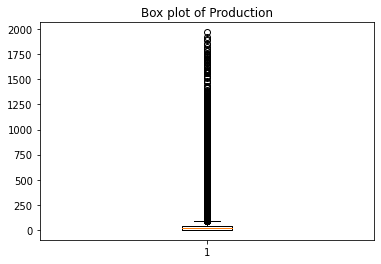

In [ ]:
#checking the outlier in Production
plt.boxplot(data1['Production'])
plt.title('Box plot of Production')

In [ ]:
Q1 = np.percentile(data1['Production'],25,interpolation='midpoint')
Q2 = np.percentile(data1['Production'],50,interpolation='midpoint')
Q3 = np.percentile(data1['Production'],75,interpolation='midpoint')
print('Q1-',Q1)
print('Q2-',Q2)
print('Q3-',Q3)
#find the interquartile range IQR
IQR = Q3 - Q1
print('IQR-',IQR)
low_limit = Q1 - 1.5 * IQR
upper_limit = Q3 + 1.5 * IQR
print('low_limit-',low_limit)
print('upper_limit-',upper_limit)

Q1- 1.725
Q2- 20.16
Q3- 37.445
IQR- 35.72
low_limit- -51.855
upper_limit- 91.025


In [ ]:
#Removing outlier using the loop
out=[]
for x in data['Production']:
    if((x>upper_limit)or(x<low_limit)):
        out.append(x)

In [ ]:
out

[278.5,
 370.7,
 323.53,
 399.16,
 393.65,
 267.55,
 421.8,
 448.56,
 271.43,
 491.78,
 613.0,
 408.38,
 371.82,
 167.48,
 399.24,
 521.0,
 347.11,
 434.81,
 470.32,
 141.3,
 134.01,
 183.35,
 145.02,
 136.84,
 160.77,
 125.01,
 178.07,
 195.0,
 167.25,
 192.38,
 166.77,
 142.0,
 171.53,
 159.76,
 219.34,
 429.3,
 386.6,
 628.61,
 683.42,
 579.85,
 551.12,
 762.45,
 743.61,
 348.73,
 547.72,
 715.0,
 716.61,
 616.57,
 457.7,
 589.74,
 356.0,
 434.1,
 681.83,
 696.47,
 630.4,
 646.4,
 685.44,
 794.42,
 576.62,
 659.11,
 812.59,
 842.12,
 475.86,
 682.0,
 825.0,
 778.59,
 660.16,
 558.8,
 764.24,
 483.0,
 521.42,
 733.31,
 727.89,
 699.4,
 759.9,
 834.49,
 868.79,
 714.51,
 761.24,
 526.57,
 804.85,
 697.2,
 521.22,
 944.0,
 959.4,
 784.31,
 722.98,
 980.11,
 908.0,
 773.29,
 788.9,
 707.08,
 845.3,
 921.4,
 969.41,
 987.36,
 935.11,
 646.81,
 482.99,
 833.96,
 892.64,
 783.94,
 976.0,
 959.32,
 683.23,
 649.76,
 1080.92,
 608.0,
 912.72,
 1000.19,
 465.82,
 127.6,
 133.4,
 136.7,
 171.5

In [ ]:
# Removing the ouliners
#ind1= (data1['Production']<low_limit) | (data1['Production']>upper_limit)
#data1.loc[ind1].index
#data1.drop(data1.loc[ind1].index,inplace=True)
#plt.boxplot(data1['Production'])
#plt.title('Box plot of Production')

## Feature Reduction

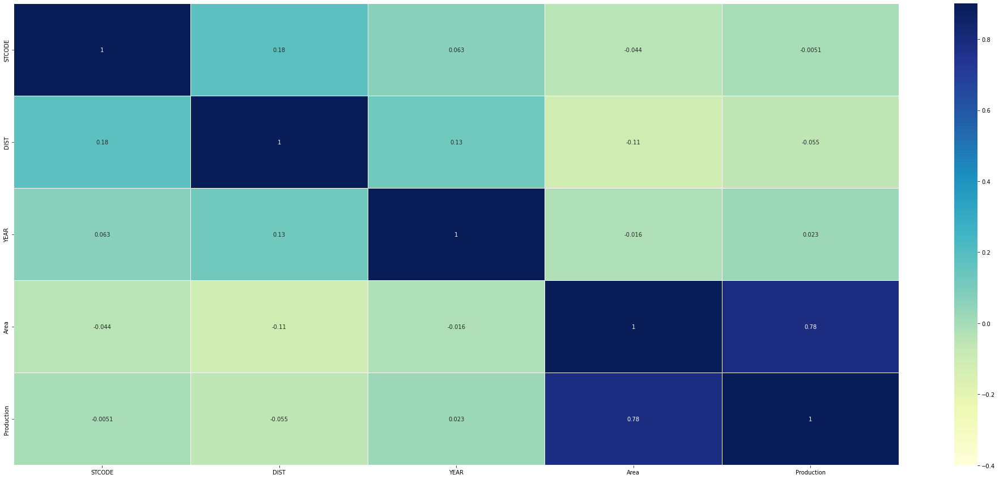

In [ ]:
corrmatrix = data.corr()
plt.subplots(figsize=(35,15))
sns.heatmap(corrmatrix, vmin=-0.4, vmax=0.9, annot=True, linewidths=0.2, cmap='YlGnBu')

ST Code and DIst columns have no effect on the dependend Variable. 

## Dropping The Least Important Independant Variables

In [ ]:
data1.columns

Index(['STCODE', 'STNAME', 'DIST', 'DISTNAME', 'YEAR', 'Area', 'Production',
       'Crops', 'Seasons'],
      dtype='object')

In [ ]:
data1_ml=data1[['STNAME','YEAR','Area','Crops','Seasons','Production']]

In [ ]:
data1_ml.head()


,STNAME,YEAR,Area,Crops,Seasons,Production
0,Andhra Pradesh,1997,185.70,RICE,Kharif,278.50
1,Andhra Pradesh,1998,194.40,RICE,Kharif,370.70
2,Andhra Pradesh,1999,189.03,RICE,Kharif,323.53
3,Andhra Pradesh,2000,207.46,RICE,Kharif,399.16
4,Andhra Pradesh,2001,178.77,RICE,Kharif,393.65


# Adding New column for Zone

In [ ]:
data1_zone=data1.copy()

In [ ]:
#Zone-Wise Production - 1997-2015
north_india = ['Punjab', 'Himachal Pradesh', 'Haryana','Rajasthan']
east_india = ['Bihar', 'Odisha', 'Jharkhand', 'West Bengal']
south_india = ['Andhra Pradesh', 'Karnataka', 'Kerala' ,'Tamil Nadu', 'Telangana']
west_india = ['Gujarat', 'Goa','Maharashtra']
central_india = ['Madhya Pradesh', 'Chhattisgarh','Uttar Pradesh','Uttarakhand']
north_east_india = ['Assam', 'Sikkim', 'Nagaland', 'Meghalaya', 'Manipur', 'Mizoram', 'Tripura', 'Arunachal Pradesh']
ut_india = ['Andaman and Nicobar Islands', 'Dadra and Nagar Haveli', 'Puducherry','Chandigarh','Daman and Diu','Delhi','Jammu and Kashmir','ladakh','Lakshadweep','Puducherry']

In [ ]:
def get_zonal_names(row):
    if row['STNAME'].strip() in north_india:
        val = 'North Zone'
    elif row['STNAME'].strip()  in south_india:
        val = 'South Zone'
    elif row['STNAME'].strip()  in east_india:
        val = 'East Zone'
    elif row['STNAME'].strip()  in west_india:
        val = 'West Zone'
    elif row['STNAME'].strip()  in central_india:
        val = 'Central Zone'
    elif row['STNAME'].strip()  in north_east_india:
        val = 'NE Zone'
    elif row['STNAME'].strip()  in ut_india:
        val = 'Union Terr'
    else:
        val = 'No Value'
    return val

data1_zone['Zones'] = data1_zone.apply(get_zonal_names, axis=1)


In [ ]:
data1_zone.head()

,STCODE,STNAME,DIST,DISTNAME,YEAR,Area,Production,Crops,Seasons,Zones
0,1,Andhra Pradesh,44,Srikakulam,1997,185.70,278.50,RICE,Kharif,South Zone
1,1,Andhra Pradesh,44,Srikakulam,1998,194.40,370.70,RICE,Kharif,South Zone
2,1,Andhra Pradesh,44,Srikakulam,1999,189.03,323.53,RICE,Kharif,South Zone
3,1,Andhra Pradesh,44,Srikakulam,2000,207.46,399.16,RICE,Kharif,South Zone
4,1,Andhra Pradesh,44,Srikakulam,2001,178.77,393.65,RICE,Kharif,South Zone


In [ ]:
data1_zone_ml=data1_zone[['Zones','YEAR','Area','Crops','Seasons','Production']]

In [ ]:
data1_zone_ml.head(5)

,Zones,YEAR,Area,Crops,Seasons,Production
0,South Zone,1997,185.70,RICE,Kharif,278.50
1,South Zone,1998,194.40,RICE,Kharif,370.70
2,South Zone,1999,189.03,RICE,Kharif,323.53
3,South Zone,2000,207.46,RICE,Kharif,399.16
4,South Zone,2001,178.77,RICE,Kharif,393.65


##Encoding

## One hot Encoding-State Wise Data

In [ ]:
data1_ml=pd.get_dummies(data1_ml)

In [ ]:
data1_ml.columns

Index(['YEAR', 'Area', 'Production', 'STNAME_Andhra Pradesh', 'STNAME_Assam',
       'STNAME_Bihar', 'STNAME_Chhattisgarh', 'STNAME_Gujarat',
       'STNAME_Haryana', 'STNAME_Himachal Pradesh', 'STNAME_Jharkhand',
       'STNAME_Karnataka', 'STNAME_Kerala', 'STNAME_Madhya Pradesh',
       'STNAME_Maharashtra', 'STNAME_Odisha', 'STNAME_Punjab',
       'STNAME_Rajasthan', 'STNAME_Tamil Nadu', 'STNAME_Telangana',
       'STNAME_Uttar Pradesh', 'STNAME_Uttarakhand', 'STNAME_West Bengal',
       'Crops_CPEA', 'Crops_RICE', 'Crops_RM', 'Crops_SOYA', 'Crops_WHT',
       'Seasons_Kharif', 'Seasons_Rabi', 'Seasons_Summer'],
      dtype='object')

In [ ]:
data1_ml.head()

,YEAR,Area,Production,STNAME_Andhra Pradesh,STNAME_Assam,STNAME_Bihar,STNAME_Chhattisgarh,STNAME_Gujarat,STNAME_Haryana,STNAME_Himachal Pradesh,...,STNAME_Uttarakhand,STNAME_West Bengal,Crops_CPEA,Crops_RICE,Crops_RM,Crops_SOYA,Crops_WHT,Seasons_Kharif,Seasons_Rabi,Seasons_Summer
0,1997,185.70,278.50,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
1,1998,194.40,370.70,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
2,1999,189.03,323.53,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
3,2000,207.46,399.16,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
4,2001,178.77,393.65,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0


In [ ]:
data1_ml.shape

(68355, 31)

# One hot Encoding-Zone Wise Data

In [ ]:
data1_zone_ml=pd.get_dummies(data1_zone_ml)

In [ ]:
data1_zone_ml.head()

,YEAR,Area,Production,Zones_Central Zone,Zones_East Zone,Zones_NE Zone,Zones_North Zone,Zones_South Zone,Zones_West Zone,Crops_CPEA,Crops_RICE,Crops_RM,Crops_SOYA,Crops_WHT,Seasons_Kharif,Seasons_Rabi,Seasons_Summer
0,1997,185.70,278.50,0,0,0,0,1,0,0,1,0,0,0,1,0,0
1,1998,194.40,370.70,0,0,0,0,1,0,0,1,0,0,0,1,0,0
2,1999,189.03,323.53,0,0,0,0,1,0,0,1,0,0,0,1,0,0
3,2000,207.46,399.16,0,0,0,0,1,0,0,1,0,0,0,1,0,0
4,2001,178.77,393.65,0,0,0,0,1,0,0,1,0,0,0,1,0,0


In [ ]:
data1_zone_ml.shape

(68355, 17)

##Splitting Dataset(State wise) into Training and Test set

In [ ]:
y=data1_ml['Production']
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test =train_test_split(x ,y, random_state=42, test_size=0.2)

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
import math

r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x_train, y_train)
y_pred=model.predict(x_test)

In [ ]:
print("MSE of Linear regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Linear regressor is :",r2_score(y_test,y_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Linear regressor is : 4666.447786840616
R squared value of Linear regressor is : 0.7661067711208636
MAE of Linear regressor is : 34.41469974417771
RMSE of Linear regressor is 68.3114030513253


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:

regressor = RandomForestRegressor()
regressor.fit(x_train,y_train)
y_pred=regressor.predict(x_test)
print("MSE of Random forest regressor is :",mean_squared_error(y_test,y_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y_test,y_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Random forest regressor is : 816.9240709890579
R2score when we predict using Randomn forest is  0.9590538633580031
MAE of Random forest regressor is : 9.345197198914747
RMSE of Random forest regressor is 28.58188361513387


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x_train,y_train)
y_pred= dt.predict(x_test)
print("MSE of decison tree regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of decison tree regressor is :",r2_score(y_test,y_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of decison tree regressor is : 1338.9838620490295
R squared value of decison tree regressor is : 0.9328870110162018
MAE of decison tree regressor is : 11.848827012167884
RMSE of decison tree regressor is 36.59212841649184


# Splitting Dataset(Zone wise) into Training and Test set

In [ ]:
y1=data1_zone_ml['Production']
x1=data1_zone_ml.drop(['Production'],axis=1)

In [ ]:
from sklearn.model_selection import train_test_split
x1_train, x1_test, y1_train, y1_test =train_test_split(x1 ,y1, random_state=42, test_size=0.2)

r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x1_train, y1_train)
y1_pred=model.predict(x1_test)

In [ ]:
print("MSE of Linear regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of Linear regressor is :",r2_score(y1_test,y1_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Linear regressor is : 5153.5103434677085
R squared value of Linear regressor is : 0.741694061659741
MAE of Linear regressor is : 33.42810715996872
RMSE of Linear regressor is 71.78795402759232


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x1_train,y1_train)
y1_pred=regressor.predict(x1_test)
print("MSE of Random forest regressor is :",mean_squared_error(y1_test,y1_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y1_test,y1_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Random forest regressor is : 1199.3716641291703
R2score when we predict using Randomn forest is  0.9398846994623201
MAE of Random forest regressor is : 11.668898393448758
RMSE of Random forest regressor is 34.63194571676807


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x1_train,y1_train)
y1_pred= dt.predict(x1_test)
print("MSE of decison tree regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of decison tree regressor is :",r2_score(y1_test,y1_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of decison tree regressor is : 1948.5467946346573
R squared value of decison tree regressor is : 0.902334297470463
MAE of decison tree regressor is : 14.725170563005696
RMSE of decison tree regressor is 44.14234695430973


Raw data-State Wise   

1MSE of Linear regressor is : 4666.447786840616 and the R squared value of Linear regressor is : 0.7661067711208636   

2)MSE of Random forest regressor is : 816.9240709890579 and the R2score value of Randomn forest is  0.9590538633580031     
3) MSE of decison tree regressor is : 1338.9838620490295 and the R squared value of decison tree regressor is : 0.9328870110162018      

Raw data-Zone Wise     
1) MSE of Linear regressor is : 5153.5103434677085 and the R squared value of Linear regressor is : 0.741694061659741      
2) MSE of Random forest regressor is : 1199.3716641291703and the R2score of  Randomn forest is  0.9398846994623201         
3) MSE of decison tree regressor is : 1948.5467946346573 and the  R squared value of decison tree regressor is : 0.902334297470463

##Feature Scaling

## Standardization-State wise Data

In [ ]:
y=data1_ml['Production']
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
from sklearn import preprocessing
standardisation = preprocessing.StandardScaler()
x=standardisation.fit_transform(x)

In [ ]:
x=pd.DataFrame(x)

In [ ]:
x.head()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,-1.701563,2.962960,4.813605,-0.227617,-0.292374,-0.18466,-0.222595,-0.195364,-0.1504,-0.184066,...,-0.147527,-0.191087,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
1,-1.518126,3.129810,4.813605,-0.227617,-0.292374,-0.18466,-0.222595,-0.195364,-0.1504,-0.184066,...,-0.147527,-0.191087,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
2,-1.334688,3.026823,4.813605,-0.227617,-0.292374,-0.18466,-0.222595,-0.195364,-0.1504,-0.184066,...,-0.147527,-0.191087,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
3,-1.151251,3.380275,4.813605,-0.227617,-0.292374,-0.18466,-0.222595,-0.195364,-0.1504,-0.184066,...,-0.147527,-0.191087,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
4,-0.967813,2.830056,4.813605,-0.227617,-0.292374,-0.18466,-0.222595,-0.195364,-0.1504,-0.184066,...,-0.147527,-0.191087,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x_train, y_train)
y_pred=model.predict(x_test)
print("MSE of Linear regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Linear regressor is :",r2_score(y_test,y_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))


MSE of Linear regressor is : 4666.447786840616
R squared value of Linear regressor is : 0.7661067711208636
MAE of Linear regressor is : 34.41469974417771
RMSE of Linear regressor is 68.3114030513253


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x_train,y_train)
y_pred=regressor.predict(x_test)
print("MSE of Random forest regressor is :",mean_squared_error(y_test,y_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y_test,y_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Random forest regressor is : 810.2597009021346
R2score when we predict using Randomn forest is  0.9593878971047155
MAE of Random forest regressor is : 9.323996409624883
RMSE of Random forest regressor is 28.46506105565443


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x_train,y_train)
y_pred= dt.predict(x_test)
print("MSE of decison tree regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of decison tree regressor is :",r2_score(y_test,y_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of decison tree regressor is : 1369.6041810345685
R squared value of decison tree regressor is : 0.9313522493293716
MAE of decison tree regressor is : 11.953795140740356
RMSE of decison tree regressor is 37.0081637079519


There is no difference in r2 value,Mean_Squared_Error after standardisations in each model

# Standardization-Zone wise Data

In [ ]:
y1=data1_zone_ml['Production']
x1=data1_zone_ml.drop(['Production'],axis=1)

In [ ]:
standardisation = preprocessing.StandardScaler()
x1=standardisation.fit_transform(x1)

In [ ]:
x1=pd.DataFrame(x1)

In [ ]:
x1.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,-1.701563,2.962960,-0.643737,-0.507988,-0.227617,-0.435205,2.11728,-0.35337,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
1,-1.518126,3.129810,-0.643737,-0.507988,-0.227617,-0.435205,2.11728,-0.35337,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
2,-1.334688,3.026823,-0.643737,-0.507988,-0.227617,-0.435205,2.11728,-0.35337,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
3,-1.151251,3.380275,-0.643737,-0.507988,-0.227617,-0.435205,2.11728,-0.35337,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248
4,-0.967813,2.830056,-0.643737,-0.507988,-0.227617,-0.435205,2.11728,-0.35337,-0.408248,1.154701,-0.408248,-0.408248,-0.408248,1.581139,-1.154701,-0.408248


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x1_train, y1_train)
y1_pred=model.predict(x1_test)

In [ ]:
print("MSE of Linear regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of Linear regressor is :",r2_score(y1_test,y1_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Linear regressor is : 5153.5103434677085
R squared value of Linear regressor is : 0.741694061659741
MAE of Linear regressor is : 33.42810715996872
RMSE of Linear regressor is 71.78795402759232


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x1_train,y1_train)
y1_pred=regressor.predict(x1_test)
print("MSE of Random forest regressor is :",mean_squared_error(y1_test,y1_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y1_test,y1_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Random forest regressor is : 1191.8609064322145
R2score when we predict using Randomn forest is  0.940261156126857
MAE of Random forest regressor is : 11.620950943875078
RMSE of Random forest regressor is 34.52333857598674


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x1_train,y1_train)
y1_pred= dt.predict(x1_test)
print("MSE of decison tree regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of decison tree regressor is :",r2_score(y1_test,y1_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of decison tree regressor is : 1958.7542259983916
R squared value of decison tree regressor is : 0.9018226772425547
MAE of decison tree regressor is : 14.735834011180662
RMSE of decison tree regressor is 44.257815422797265


After Standardization-State Wise Data  

1MSE of Linear regressor is : 4666.448 and the R squared value of Linear regressor is : 0.766   

2)MSE of Random forest regressor is : 810.26 and the R2score value of Randomn forest is  0.9594     
3) MSE of decison tree regressor is : 1369.61 and the R squared value of decison tree regressor is : 0.9314     

Zone Wise Data    
1) MSE of Linear regressor is 5153.51 and the R squared value of Linear regressor is : 0.7417      
2) MSE of Random forest regressor is : 1191.87and the R2score of  Randomn forest is 0.9403        
3) MSE of decison tree regressor is 1958.75 and the  R squared value of decison tree regressor is : 0.9018

## MIN- MAX SCALING-STATE WISE DATA

In [ ]:
y=data1_ml['Production']
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
min_max=preprocessing.MinMaxScaler(feature_range=(0,1))
x=min_max.fit_transform(x)

In [ ]:
x=pd.DataFrame(x)

In [ ]:
x.head()

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.055556,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.111111,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.166667,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.222222,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x_train, y_train)
y_pred=model.predict(x_test)
print("MSE of Linear regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Linear regressor is :",r2_score(y_test,y_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Linear regressor is : 4666.447786840616
R squared value of Linear regressor is : 0.7661067711208636
MAE of Linear regressor is : 34.41469974417771
RMSE of Linear regressor is 68.3114030513253


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x_train,y_train)
y_pred=regressor.predict(x_test)
print("MSE of Random forest regressor is :",mean_squared_error(y_test,y_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y_test,y_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Random forest regressor is : 811.1363000489655
R2score when we predict using Randomn forest is  0.9593439599143192
MAE of Random forest regressor is : 9.342568151200155
RMSE of Random forest regressor is 28.480454702286014


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x_train,y_train)
y_pred= dt.predict(x_test)
print("MSE of decison tree regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of decison tree regressor is :",r2_score(y_test,y_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of decison tree regressor is : 1363.8654530940378
R squared value of decison tree regressor is : 0.9316398877363532
MAE of decison tree regressor is : 11.954538441644953
RMSE of decison tree regressor is 36.93054904945278


# MIN- MAX SCALING-ZONE WISE DATA

In [ ]:
x1=data1_zone_ml.drop(['Production'],axis=1)

In [ ]:
min_max=preprocessing.MinMaxScaler(feature_range=(0,1))
x1=min_max.fit_transform(x1)

In [ ]:
x1=pd.DataFrame(x1)

In [ ]:
x1.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.000000,0.270306,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.055556,0.282969,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.111111,0.275153,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.166667,0.301980,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.222222,0.260218,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x1_train, y1_train)
y1_pred=model.predict(x1_test)

In [ ]:
print("MSE of Linear regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of Linear regressor is :",r2_score(y1_test,y1_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Linear regressor is : 5153.5103434677085
R squared value of Linear regressor is : 0.741694061659741
MAE of Linear regressor is : 33.42810715996872
RMSE of Linear regressor is 71.78795402759232


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x1_train,y1_train)
y1_pred=regressor.predict(x1_test)
print("MSE of Random forest regressor is :",mean_squared_error(y1_test,y1_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y1_test,y1_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Random forest regressor is : 1194.6392008288797
R2score when we predict using Randomn forest is  0.9401219015424502
MAE of Random forest regressor is : 11.63845397067078
RMSE of Random forest regressor is 34.563553070089306


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x1_train,y1_train)
y1_pred= dt.predict(x1_test)
print("MSE of decison tree regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of decison tree regressor is :",r2_score(y1_test,y1_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of decison tree regressor is : 1952.8417412662131
R squared value of decison tree regressor is : 0.9021190247445255
MAE of decison tree regressor is : 14.662306105394695
RMSE of decison tree regressor is 44.19096900121351


After Min_Max Scaling -State Wise Data

1MSE of Linear regressor is 4666.45 and the R squared value of Linear regressor is 0.766

2)MSE of Random forest regressor is 811.14 and the R2score value of Randomn forest is 0.9593
3) MSE of decison tree regressor is 1163.87 and the R squared value of decison tree regressor is 0.9316

Zone Wise Data
1) MSE of Linear regressor is 5153.51 and the R squared value of Linear regressor is 0.7414
2) MSE of Random forest regressor is 1194.63 and the R2score of Randomn forest is 0.9401
3) MSE of decison tree regressor is 1952.84 and the R squared value of decison tree regressor is 0.9021



## NORMALIZATION-STATE WISE DATA

In [ ]:
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
x=preprocessing.normalize(x)

In [ ]:
x=pd.DataFrame(x)

In [ ]:
x.head()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,0.995704,0.092590,0.000499,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000499,0.0,0.0,0.0,0.000499,0.0,0.0
1,0.995300,0.096840,0.000498,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0
2,0.995558,0.094142,0.000498,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0
3,0.994663,0.103176,0.000497,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000497,0.0,0.0,0.0,0.000497,0.0,0.0
4,0.996033,0.088986,0.000498,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x_train, y_train)
y_pred=model.predict(x_test)
print("MSE of Linear regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Linear regressor is :",r2_score(y_test,y_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Linear regressor is : 4666.447786840616
R squared value of Linear regressor is : 0.7661067711208636
MAE of Linear regressor is : 34.41469974417771
RMSE of Linear regressor is 68.3114030513253


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x_train,y_train)
y_pred=regressor.predict(x_test)
print("MSE of Random forest regressor is :",mean_squared_error(y_test,y_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y_test,y_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Random forest regressor is : 810.1435673818797
R2score when we predict using Randomn forest is  0.9593937179871671
MAE of Random forest regressor is : 9.328515310998148
RMSE of Random forest regressor is 28.463021051565832


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x_train,y_train)
y_pred= dt.predict(x_test)
print("MSE of decison tree regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of decison tree regressor is :",r2_score(y_test,y_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of decison tree regressor is : 1355.318871529154
R squared value of decison tree regressor is : 0.9320682623050619
MAE of decison tree regressor is : 11.935491606320964
RMSE of decison tree regressor is 36.81465566223802


# NORMALIZATION-ZONE WISE DATA

In [ ]:
x1=data1_zone_ml.drop(['Production'],axis=1)

In [ ]:
x1=preprocessing.normalize(x1)

In [ ]:
x1=pd.DataFrame(x1)

In [ ]:
x1.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.995704,0.092590,0.0,0.0,0.0,0.0,0.000499,0.0,0.0,0.000499,0.0,0.0,0.0,0.000499,0.0,0.0
1,0.995300,0.096840,0.0,0.0,0.0,0.0,0.000498,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0
2,0.995558,0.094142,0.0,0.0,0.0,0.0,0.000498,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0
3,0.994663,0.103176,0.0,0.0,0.0,0.0,0.000497,0.0,0.0,0.000497,0.0,0.0,0.0,0.000497,0.0,0.0
4,0.996033,0.088986,0.0,0.0,0.0,0.0,0.000498,0.0,0.0,0.000498,0.0,0.0,0.0,0.000498,0.0,0.0


r2_Score and Mean_Squared_Error Based On Linear Regression

In [ ]:
model = LinearRegression()
model.fit(x1_train, y1_train)
y1_pred=model.predict(x1_test)

In [ ]:
print("MSE of Linear regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of Linear regressor is :",r2_score(y1_test,y1_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Linear regressor is : 5153.5103434677085
R squared value of Linear regressor is : 0.741694061659741
MAE of Linear regressor is : 33.42810715996872
RMSE of Linear regressor is 71.78795402759232


r2_Score and Mean_Squared_Error Based On Random Forest Regressior

In [ ]:
regressor = RandomForestRegressor()
regressor.fit(x1_train,y1_train)
y1_pred=regressor.predict(x1_test)
print("MSE of Random forest regressor is :",mean_squared_error(y1_test,y1_pred))
print("R2score when we predict using Randomn forest is ",r2_score(y1_test,y1_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of Random forest regressor is : 1192.940174913199
R2score when we predict using Randomn forest is  0.9402070606775184
MAE of Random forest regressor is : 11.678085743480581
RMSE of Random forest regressor is 34.53896603711812


r2_Score and Mean_Squared_Error Based On Decision tree regressor

In [ ]:
dt=DecisionTreeRegressor()
dt.fit(x1_train,y1_train)
y1_pred= dt.predict(x1_test)
print("MSE of decison tree regressor is :",mean_squared_error(y1_test,y1_pred))
print("R squared value of decison tree regressor is :",r2_score(y1_test,y1_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y1_test,y1_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y1_test,y1_pred)))

MSE of decison tree regressor is : 1975.0085788848744
R squared value of decison tree regressor is : 0.9010079712276966
MAE of decison tree regressor is : 14.73841221809067
RMSE of decison tree regressor is 44.44106860646889


After Normaliztion  -State Wise Data

1MSE of Linear regressor is 4666.45 and the R squared value of Linear regressor is 0.766

2)MSE of Random forest regressor is 810.14 and the R2score value of Randomn forest is 0.9594
3) MSE of decison tree regressor is 1355.32 and the R squared value of decison tree regressor is 0.9321

Zone Wise Data
1) MSE of Linear regressor is 5153.51 and the R squared value of Linear regressor is 0.7417
2) MSE of Random forest regressor is 1192.94 and the R2score of Randomn forest is 0.9402
3) MSE of decison tree regressor is 1975.008 and the R squared value of decison tree regressor is 0.9010

Random Forest regressor after standardisation provides better accuracy .

# FINAL WEEK-MODEL BUIDING

# MULTIPLE LINEAR REGRESSION

In [ ]:
y=data1_ml['Production']
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
import math
model = LinearRegression()
model.fit(x_train,y_train)
y_pred=model.predict(x_test)
print("MSE of Linear regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Linear regressor is :",r2_score(y_test,y_pred))
print("MAE of Linear regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Linear regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Linear regressor is : 4666.447786840616
R squared value of Linear regressor is : 0.7661067711208636
MAE of Linear regressor is : 34.41469974417771
RMSE of Linear regressor is 68.3114030513253


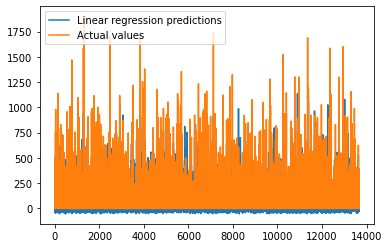

In [ ]:
plt.plot(figsize=(20,8))
plt.plot(y_pred,label="Linear regression predictions")
plt.plot(np.array(y_test),label="Actual values")
plt.legend(loc="upper left")
plt.show()

# Decision tree regressor

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
dt=DecisionTreeRegressor()
dt.fit(x_train,y_train)
y_pred= dt.predict(x_test)
print("MSE of decison tree regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of decison tree regressor is :",r2_score(y_test,y_pred))
print("MAE of decison tree regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of decison tree regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of decison tree regressor is : 1389.5798776083238
R squared value of decison tree regressor is : 0.9303510209037753
MAE of decison tree regressor is : 11.944968723332641
RMSE of decison tree regressor is 37.27706905871656


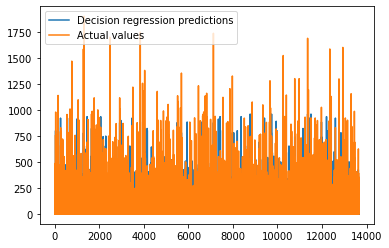

In [ ]:
plt.plot(figsize=(20,8))
plt.plot(y_pred,label="Decision regression predictions")
plt.plot(np.array(y_test),label="Actual values")
plt.legend(loc="upper left")
plt.show()

# Random forest regressor

In [ ]:
y=data1_ml['Production']
x=data1_ml.drop(['Production'],axis=1)

In [ ]:
from sklearn import preprocessing
standardisation = preprocessing.StandardScaler()
x=standardisation.fit_transform(x)

In [ ]:
x=pd.DataFrame(x)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
regressor=RandomForestRegressor()
regressor.fit(x_train,y_train)
y_pred=regressor.predict(x_test)
print("MSE of Random forest regressor is :",mean_squared_error(y_test,y_pred))
print("R squared value of Random forest regressor is :",r2_score(y_test,y_pred))
print("MAE of Random forest regressor is :",mean_absolute_error(y_test,y_pred))
print("RMSE of Random forest regressor is",math.sqrt(mean_squared_error(y_test,y_pred)))

MSE of Random forest regressor is : 807.1727441219792
R squared value of Random forest regressor is : 0.9595426225665019
MAE of Random forest regressor is : 9.341660680772213
RMSE of Random forest regressor is 28.410785700539492


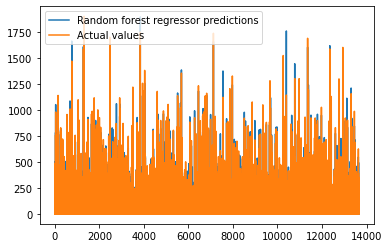

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.plot(figsize=(20,8))
plt.plot(y_pred,label="Random forest regressor predictions")
plt.plot(np.array(y_test),label="Actual values")
plt.legend(loc="upper left")
plt.show()

In [ ]:
test1=[[2002,185.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0]]
test2= pd.DataFrame(test1,columns= 
['YEAR','Area','STNAME_Andhra Pradesh','STNAME_Assam','STNAME_Bihar','STNAME_Chhattisgarh','STNAME_Gujarat','STNAME_Haryana','STNAME_Himachal Pradesh','STNAME_Jharkhand','STNAME_Karnataka','STNAME_Kerala','STNAME_Madhya Pradesh','STNAME_Maharashtra','STNAME_Odisha','STNAME_Punjab','STNAME_Rajasthan','STNAME_Tamil Nadu','STNAME_Telangana','STNAME_Uttar Pradesh','STNAME_Uttarakhand','STNAME_West Bengal','Crops_CPEA','Crops_RICE','Crops_RM','Crops_SOYA','Crops_WHT','Seasons_Kharif','Seasons_Rabi','Seasons_Summer'],dtype=int)
p=regressor.predict(test2)
print(" Result : ",p[0])

 Result :  516.3277000000002


Based on MSE, R2 value,MAE and RMSE parameter, state wise data gives better accuracy compared to zone wise data. Compared to Other models,Random Forest regresor provides better result after standardization
